# Generating Images of Cats and Dogs -- Group 35 
## Conditional GAN
Gustav Lahti (lahtig@student.chalmers.se) and Agnes Mårdh (agnesma@student.chalmers.se) 

In [24]:
import os

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import torchvision.models as models
import torchvision.utils as vutils

import matplotlib.animation as animation
from IPython.display import HTML

import numpy as np

import matplotlib.pyplot as plt

# Just for benchmarking
import time

%matplotlib inline

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [25]:
# Root for images
dataroot = "train"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
# 15 epochs ~ 10 minutes
num_epochs = 15 * 6

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

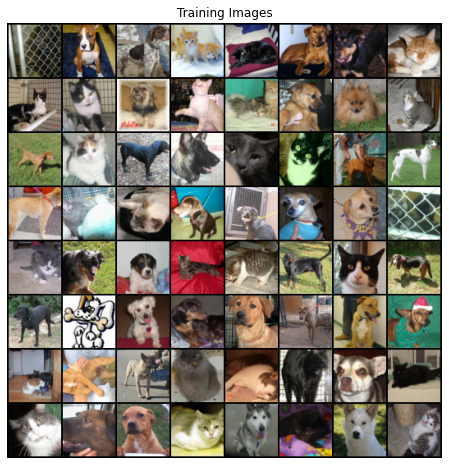

In [26]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [27]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [28]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        
        self.label_emb = nn.Embedding(2, 2)
        
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz + 2, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input, labels):
        c = self.label_emb(labels).view(input.shape[0], 2, 1, 1)
        input = torch.cat([input, c], 1)
        return self.main(input)

In [29]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
#if (device.type == 'cuda') and (ngpu > 1):
#    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (label_emb): Embedding(2, 2)
  (main): Sequential(
    (0): ConvTranspose2d(102, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias

In [30]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        
        self.in_shape = (64,64,3)
        
        self.embedder = nn.Sequential(
            nn.Embedding(2,2),
            nn.Linear(2, self.in_shape[0] * self.in_shape[1])
        )
        
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc + 1, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input, labels):
        #print(input.shape)
        c = self.embedder(labels)
        #print(c.shape)
        c = c.view(input.shape[0], 1, self.in_shape[0], self.in_shape[1])
        #print(c.shape)
        input = torch.cat([input, c], 1)
        #print(input.shape)
        #print("Wohoo!")
        return self.main(input)

In [31]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (embedder): Sequential(
    (0): Embedding(2, 2)
    (1): Linear(in_features=2, out_features=4096, bias=True)
  )
  (main): Sequential(
    (0): Conv2d(4, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Co

In [32]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
fixed_fake_labels = torch.randint(0, 2, (64, 1), device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [33]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

# Reference time point for how long the training takes
start_time = time.perf_counter()

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, (data, real_labels) in enumerate(dataloader, 0):

        real_labels = real_labels.to(device)
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu, real_labels).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        ### OUR BOIII
        fake_labels = torch.randint(0,2,(b_size,)).to(device)
        ### END BOIII
        
        # Generate fake image batch with G
        fake = netG(noise, fake_labels)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach(), fake_labels).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake, fake_labels).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise, fixed_fake_labels).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
# Calculate and display the amount of time the training took
elapsed_time = time.perf_counter() - start_time
print("Training was done in {:.0f}h {:02.0f}m {:.3f}s".format(elapsed_time // 3600, 
                                                              elapsed_time % 3600 // 60, 
                                                              elapsed_time % 60))

Starting Training Loop...
[0/90][0/184]	Loss_D: 1.7427	Loss_G: 6.9108	D(x): 0.3978	D(G(z)): 0.4363 / 0.0055
[0/90][50/184]	Loss_D: 0.0429	Loss_G: 8.3843	D(x): 0.9793	D(G(z)): 0.0172 / 0.0003
[0/90][100/184]	Loss_D: 0.6885	Loss_G: 4.0251	D(x): 0.7281	D(G(z)): 0.0886 / 0.0336
[0/90][150/184]	Loss_D: 1.1260	Loss_G: 1.2414	D(x): 0.4492	D(G(z)): 0.0309 / 0.3663
[1/90][0/184]	Loss_D: 0.2605	Loss_G: 4.0671	D(x): 0.8704	D(G(z)): 0.0908 / 0.0218
[1/90][50/184]	Loss_D: 0.3781	Loss_G: 8.8500	D(x): 0.7940	D(G(z)): 0.0025 / 0.0007
[1/90][100/184]	Loss_D: 1.0945	Loss_G: 3.5297	D(x): 0.4685	D(G(z)): 0.0057 / 0.0778
[1/90][150/184]	Loss_D: 0.2660	Loss_G: 3.4853	D(x): 0.8847	D(G(z)): 0.1019 / 0.0408
[2/90][0/184]	Loss_D: 1.1722	Loss_G: 1.3121	D(x): 0.5025	D(G(z)): 0.1748 / 0.3471
[2/90][50/184]	Loss_D: 1.4711	Loss_G: 8.2628	D(x): 0.9565	D(G(z)): 0.6757 / 0.0018
[2/90][100/184]	Loss_D: 1.1670	Loss_G: 1.3900	D(x): 0.4393	D(G(z)): 0.0485 / 0.3291
[2/90][150/184]	Loss_D: 0.4523	Loss_G: 3.4333	D(x): 0.8341	

[24/90][100/184]	Loss_D: 0.4819	Loss_G: 2.6636	D(x): 0.6913	D(G(z)): 0.0591 / 0.1001
[24/90][150/184]	Loss_D: 0.4675	Loss_G: 3.0552	D(x): 0.8476	D(G(z)): 0.2200 / 0.0672
[25/90][0/184]	Loss_D: 1.0938	Loss_G: 6.5101	D(x): 0.9193	D(G(z)): 0.5788 / 0.0023
[25/90][50/184]	Loss_D: 0.5527	Loss_G: 2.2882	D(x): 0.7904	D(G(z)): 0.2309 / 0.1277
[25/90][100/184]	Loss_D: 0.6797	Loss_G: 1.6987	D(x): 0.6673	D(G(z)): 0.1688 / 0.2467
[25/90][150/184]	Loss_D: 1.1264	Loss_G: 4.3903	D(x): 0.9083	D(G(z)): 0.5620 / 0.0198
[26/90][0/184]	Loss_D: 0.9027	Loss_G: 5.1316	D(x): 0.9566	D(G(z)): 0.5097 / 0.0085
[26/90][50/184]	Loss_D: 0.8494	Loss_G: 3.6803	D(x): 0.9033	D(G(z)): 0.4725 / 0.0359
[26/90][100/184]	Loss_D: 0.5045	Loss_G: 2.7879	D(x): 0.7445	D(G(z)): 0.1404 / 0.0958
[26/90][150/184]	Loss_D: 0.3944	Loss_G: 3.3290	D(x): 0.8693	D(G(z)): 0.1889 / 0.0545
[27/90][0/184]	Loss_D: 1.2929	Loss_G: 0.5199	D(x): 0.3405	D(G(z)): 0.0266 / 0.6571
[27/90][50/184]	Loss_D: 0.5528	Loss_G: 3.4521	D(x): 0.8669	D(G(z)): 0.301

[49/90][0/184]	Loss_D: 0.5199	Loss_G: 5.2499	D(x): 0.9793	D(G(z)): 0.3516 / 0.0070
[49/90][50/184]	Loss_D: 0.2887	Loss_G: 2.8298	D(x): 0.8278	D(G(z)): 0.0769 / 0.0885
[49/90][100/184]	Loss_D: 2.1903	Loss_G: 7.8052	D(x): 0.9901	D(G(z)): 0.7905 / 0.0012
[49/90][150/184]	Loss_D: 0.4458	Loss_G: 2.5977	D(x): 0.7904	D(G(z)): 0.1418 / 0.1154
[50/90][0/184]	Loss_D: 0.4258	Loss_G: 2.4644	D(x): 0.7651	D(G(z)): 0.1009 / 0.1317
[50/90][50/184]	Loss_D: 0.3088	Loss_G: 3.1499	D(x): 0.8345	D(G(z)): 0.1006 / 0.0618
[50/90][100/184]	Loss_D: 0.7625	Loss_G: 5.6485	D(x): 0.9555	D(G(z)): 0.4286 / 0.0063
[50/90][150/184]	Loss_D: 0.3147	Loss_G: 2.9828	D(x): 0.8242	D(G(z)): 0.0867 / 0.0808
[51/90][0/184]	Loss_D: 0.9698	Loss_G: 0.5339	D(x): 0.4378	D(G(z)): 0.0089 / 0.6716
[51/90][50/184]	Loss_D: 0.4456	Loss_G: 2.2869	D(x): 0.7315	D(G(z)): 0.0905 / 0.1405
[51/90][100/184]	Loss_D: 0.3066	Loss_G: 3.1233	D(x): 0.8159	D(G(z)): 0.0706 / 0.0685
[51/90][150/184]	Loss_D: 0.2310	Loss_G: 3.9246	D(x): 0.9262	D(G(z)): 0.130

[73/90][100/184]	Loss_D: 0.1028	Loss_G: 3.6406	D(x): 0.9473	D(G(z)): 0.0439 / 0.0420
[73/90][150/184]	Loss_D: 0.2587	Loss_G: 3.7375	D(x): 0.8896	D(G(z)): 0.1021 / 0.0419
[74/90][0/184]	Loss_D: 0.2395	Loss_G: 3.1504	D(x): 0.8749	D(G(z)): 0.0801 / 0.0664
[74/90][50/184]	Loss_D: 0.4892	Loss_G: 2.6043	D(x): 0.8429	D(G(z)): 0.2012 / 0.1131
[74/90][100/184]	Loss_D: 0.2431	Loss_G: 3.0809	D(x): 0.8325	D(G(z)): 0.0414 / 0.0780
[74/90][150/184]	Loss_D: 0.2469	Loss_G: 2.7601	D(x): 0.8301	D(G(z)): 0.0441 / 0.1018
[75/90][0/184]	Loss_D: 0.1511	Loss_G: 4.1016	D(x): 0.9038	D(G(z)): 0.0423 / 0.0293
[75/90][50/184]	Loss_D: 0.1169	Loss_G: 3.7052	D(x): 0.9331	D(G(z)): 0.0425 / 0.0410
[75/90][100/184]	Loss_D: 1.5667	Loss_G: 3.7727	D(x): 0.7470	D(G(z)): 0.5350 / 0.0620
[75/90][150/184]	Loss_D: 0.3673	Loss_G: 4.1038	D(x): 0.9186	D(G(z)): 0.2056 / 0.0259
[76/90][0/184]	Loss_D: 0.2678	Loss_G: 3.7877	D(x): 0.9173	D(G(z)): 0.1424 / 0.0362
[76/90][50/184]	Loss_D: 0.3262	Loss_G: 5.6929	D(x): 0.9748	D(G(z)): 0.232

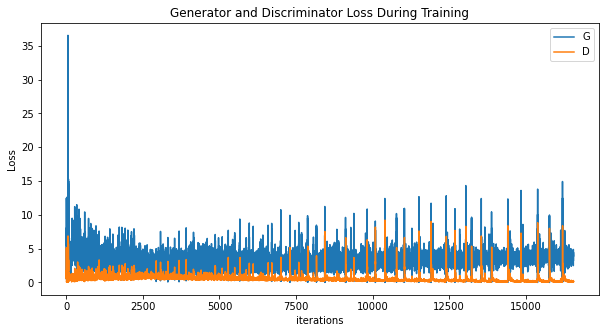

In [34]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

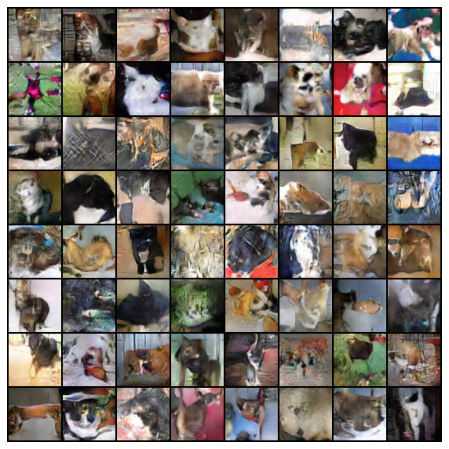

In [35]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

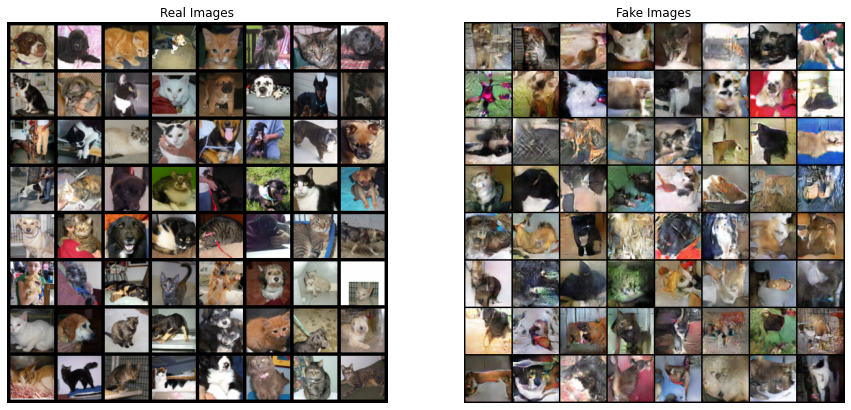

In [36]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()